In [1]:
# HSL (for hue, saturation, lightness)
# RGB (Red,Green,Blue)

In [5]:
import cv2
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

In [6]:
path = "DATA/00-puppy.jpg"

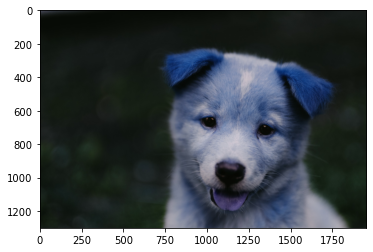

In [7]:
img = cv2.imread(filename = path)
plt.imshow(img)
plt.show()

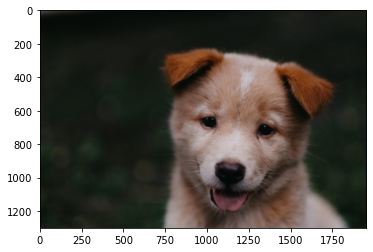

In [9]:
fix_img = cv2.cvtColor(src = img, code = cv2.COLOR_BGR2RGB)
plt.imshow(fix_img)
plt.show()

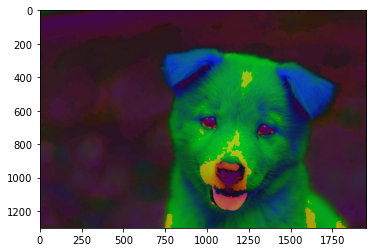

In [21]:
hls_img = cv2.cvtColor(src = fix_img, code = cv2.COLOR_RGB2HLS)
plt.imshow(hls_img)
plt.show()

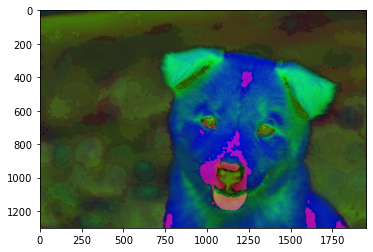

In [23]:
hsv_img = cv2.cvtColor(src = fix_img, code = cv2.COLOR_RGB2HSV)
plt.imshow(hsv_img)
plt.show()

## 

In [25]:
import cv2
import numpy as np

In [37]:
path1 = "DATA/dog_backpack.jpg"
path2 = "DATA/watermark_no_copy.png"

img1 = cv2.imread(path1)
img1 = cv2.cvtColor(src = img1, code = cv2.COLOR_BGR2RGB)

img2 = cv2.imread(path2)
img2 = cv2.cvtColor(src = img2, code = cv2.COLOR_BGR2RGB)

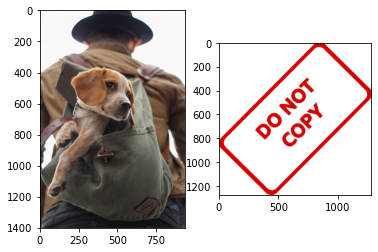

In [38]:
plt.subplot(1,2,1)
plt.imshow(img1)

plt.subplot(1,2,2)
plt.imshow(img2)

plt.show()

In [39]:
print("Img1 Shape : {}".format(img1.shape))
print("Img2 Shape : {}".format(img2.shape))

Img1 Shape : (1401, 934, 3)
Img2 Shape : (1280, 1277, 3)


In [40]:
# Blending Images of The Same Size

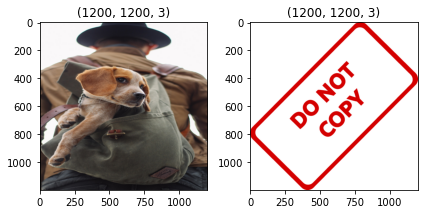

In [43]:
resize_img1 = cv2.resize(src = img1,dsize = (1200,1200))
resize_img2 = cv2.resize(src = img2,dsize = (1200,1200))

plt.subplot(1,2,1)
plt.imshow(resize_img1)
plt.title(f"{resize_img1.shape}")

plt.subplot(1,2,2)
plt.imshow(resize_img2)
plt.title(f"{resize_img2.shape}")

plt.tight_layout()
plt.show()

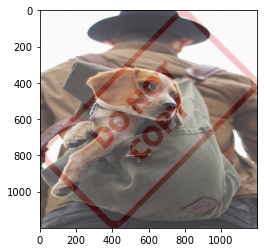

In [59]:
blended = cv2.addWeighted(src1 = resize_img1,alpha = 0.8, src2 = resize_img2, beta = 0.2, gamma = 0)
plt.imshow(blended)
plt.show()

In [60]:
# Overlay Small Image On Top Of A Larger Image (No Blending)
# Numpy reassignment

In [79]:
path1 = "DATA/dog_backpack.jpg"
path2 = "DATA/watermark_no_copy.png"

img1 = cv2.imread(path1)
img1 = cv2.cvtColor(src = img1, code = cv2.COLOR_BGR2RGB)

img2 = cv2.imread(path2)
img2 = cv2.cvtColor(src = img2, code = cv2.COLOR_BGR2RGB)

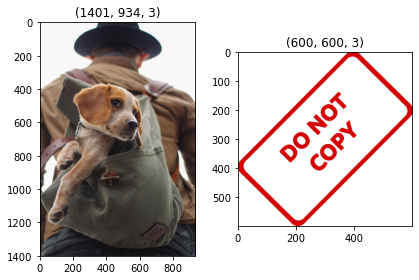

In [82]:
img2_resize = cv2.resize(src = img2, dsize = (600,600))

plt.subplot(1,2,1)
plt.imshow(img1)
plt.title(f"{img1.shape}")

plt.subplot(1,2,2)
plt.imshow(img2_resize)
plt.title(f"{img2_resize.shape}")

plt.tight_layout()
plt.show()

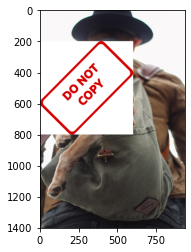

In [83]:
large_img = img1
small_img = img2_resize

x_offset = 0
y_offset = 200

x_end = x_offset + img2_resize.shape[1]
y_end = y_offset + img2_resize.shape[0]

large_img[y_offset:y_end,x_offset:x_end] = small_img

plt.imshow(large_img)
plt.show()

----

## Blend Together Images Of Different Sizes

In [84]:
import cv2
import numpy as np

In [91]:
path1 = "DATA/dog_backpack.jpg"
path2 = "DATA/watermark_no_copy.png"

img1 = cv2.imread(path1)
img1 = cv2.cvtColor(src = img1, code = cv2.COLOR_BGR2RGB)

img2 = cv2.imread(path2)
img2 = cv2.cvtColor(src = img2, code = cv2.COLOR_BGR2RGB)
img2 = cv2.resize(src = img2,dsize = (600,600))

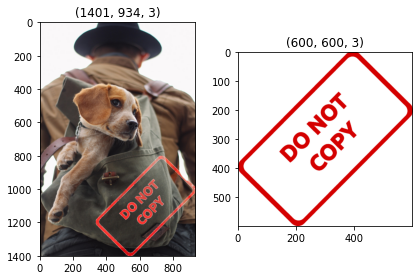

In [229]:
plt.subplot(1,2,1)
plt.imshow(img1)
plt.title(img1.shape)

plt.subplot(1,2,2)
plt.imshow(img2)
plt.title(img2.shape)

plt.tight_layout()
plt.show()

In [93]:
img1.shape

(1401, 934, 3)

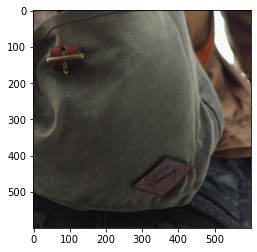

In [95]:
x_offset = img1.shape[1] - 600
y_offset = img1.shape[0] - 600

rows,cols,channels = img2.shape

roi = img1[y_offset:img1.shape[0], x_offset:img1.shape[1]]

plt.imshow(roi)
plt.show()

In [120]:
x_offset,y_offset,img1.shape

(334, 801, (1401, 934, 3))

In [96]:
roi.shape

(600, 600, 3)

## Creating A Mask

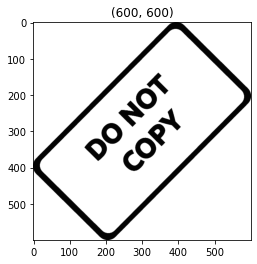

In [225]:
img2gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
plt.imshow(img2gray,cmap = "gray")
plt.title(img2gray.shape)
plt.show()

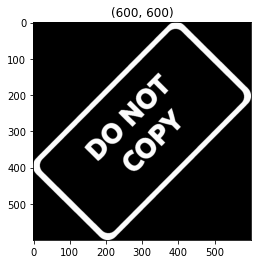

In [226]:
mask_inv = cv2.bitwise_not(img2gray)
plt.imshow(mask_inv,cmap = "gray")
plt.title(mask_inv.shape)
plt.show()

## Convert Mask to Have 3 Channels

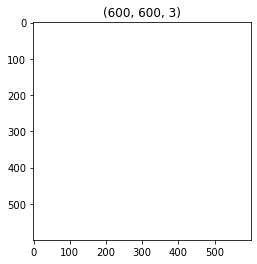

In [227]:
# Zaten benim img2 3 channels sahip 


white_background = np.full(img2.shape,255,dtype = np.uint8)
plt.imshow(white_background)
plt.title(white_background.shape)
plt.show()

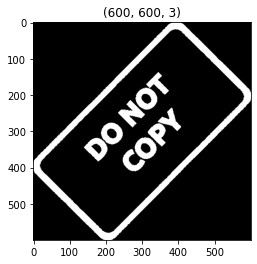

In [228]:
bk = cv2.bitwise_or(white_background,white_background, mask = mask_inv)
plt.imshow(bk)
plt.title(bk.shape)
plt.show()

## Grap Original FG Image and Place On Top Of Mask

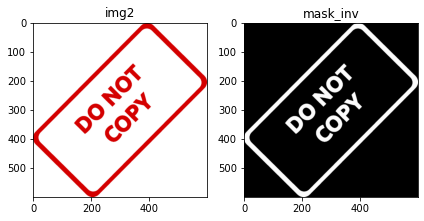

In [124]:
plt.subplot(1,2,1)
plt.imshow(img2)
plt.title("img2")

plt.subplot(1,2,2)
plt.imshow(mask_inv,cmap = "gray")
plt.title("mask_inv")

plt.tight_layout()
plt.show()

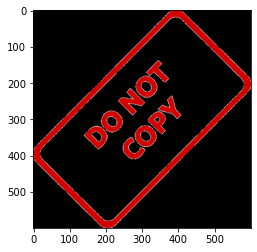

In [112]:
fg = cv2.bitwise_or(img2,img2, mask=mask_inv)
plt.imshow(fg)
plt.show()

In [113]:
fg.shape

(600, 600, 3)

## Get ROI and Blend In The Mask With The Roi

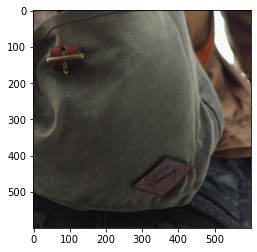

In [114]:
plt.imshow(roi)
plt.show()

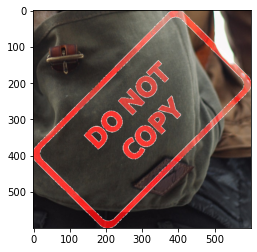

In [117]:
final_roi = cv2.bitwise_or(roi,fg)
plt.imshow(final_roi)
plt.show()

## Now add in the rest of the image

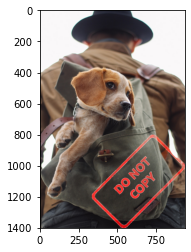

In [119]:
large_img = img1
small_img = final_roi

large_img[y_offset : y_offset + small_img.shape[0], x_offset : x_offset + small_img.shape[1]] = small_img

plt.imshow(large_img)
plt.show()

----

## IMAGE THRESHOLDING

In [192]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

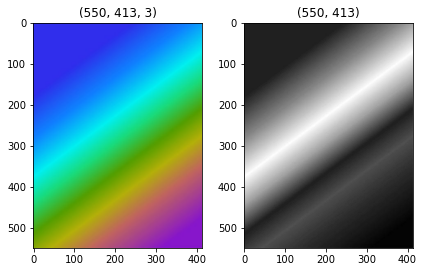

In [193]:
path_1 = "DATA/rainbow.jpg"

img = cv2.imread(path_1)

# Adding the 0 flag to read it in black and white
img_gray = cv2.imread(path_1,0)


plt.subplot(1,2,1)
plt.imshow(img)
plt.title(img.shape)

plt.subplot(1,2,2)
plt.imshow(img_gray, cmap = "gray")
plt.title(img_gray.shape)

plt.tight_layout()
plt.show()

In [194]:
img_gray.max(),img_gray.min(),img.max(),img.min()

(214, 87, 255, 0)

In [200]:
# 255 / 2 = 127.5

ret1, thresh1 = cv2.threshold(src = img_gray, thresh = 127,maxval = 255,type = cv2.THRESH_BINARY)
ret2, thresh2 = cv2.threshold(src = img_gray, thresh = 127,maxval = 255,type = cv2.THRESH_BINARY_INV)
ret3, thresh3 = cv2.threshold(src = img_gray, thresh = 127,maxval = 255,type = cv2.THRESH_TRUNC)
ret4, thresh4 = cv2.threshold(src = img_gray, thresh = 127,maxval = 255,type = cv2.THRESH_TOZERO)
ret5, thresh5 = cv2.threshold(src = img_gray, thresh = 127,maxval = 255,type = cv2.THRESH_TOZERO_INV)

In [201]:
thresh1.shape,thresh2.shape,thresh3.shape

((550, 413), (550, 413), (550, 413))

In [202]:
# 0 yada 255 çevirdi...

ret1,ret2,ret3,thresh1.max(),thresh1.min(),thresh2.max(),thresh2.min(),thresh3.max(),thresh3.min()

(127.0, 127.0, 127.0, 255, 0, 255, 0, 127, 87)

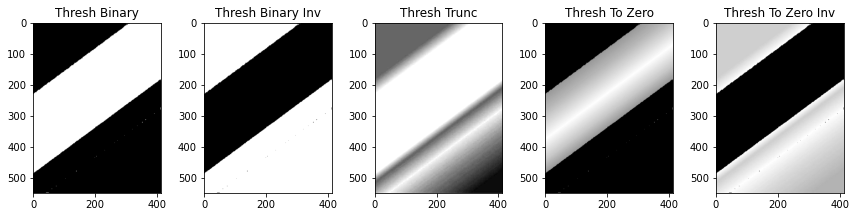

In [204]:
plt.figure(figsize = (12,6))

plt.subplot(1,5,1)
plt.imshow(thresh1, cmap = "gray")
plt.title("Thresh Binary")

plt.subplot(1,5,2)
plt.imshow(thresh2, cmap = "gray")
plt.title("Thresh Binary Inv")

plt.subplot(1,5,3)
plt.imshow(thresh3, cmap = "gray")
plt.title("Thresh Trunc")

plt.subplot(1,5,4)
plt.imshow(thresh4, cmap = "gray")
plt.title("Thresh To Zero")

plt.subplot(1,5,5)
plt.imshow(thresh5, cmap = "gray")
plt.title("Thresh To Zero Inv")

plt.tight_layout()
plt.show()

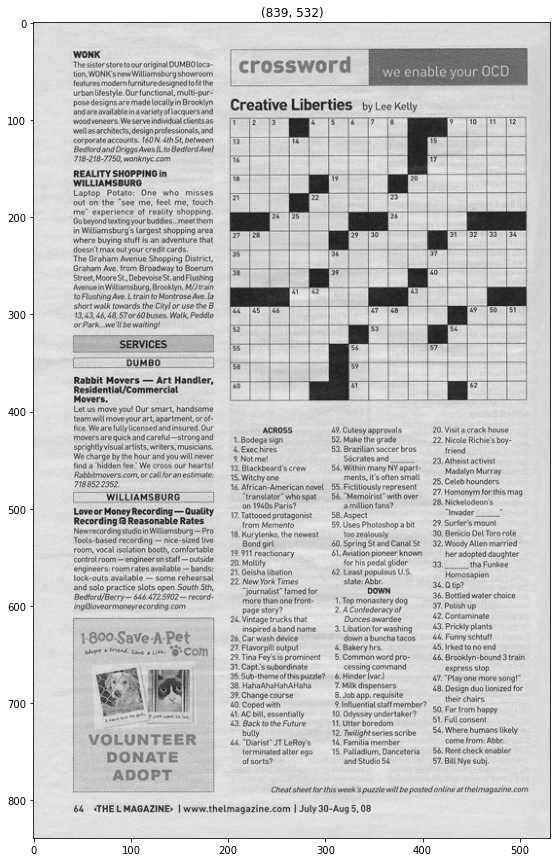

In [206]:
path_2 = "DATA/crossword.jpg"

# img_2 = cv2.imread(path_2,  0) # Yeterli !!

img_2 = cv2.imread(path_2, cv2.COLOR_BGR2RGB)
img_2 = cv2.cvtColor(src = img_2,code = cv2.COLOR_RGB2GRAY)

def show_pic(image):
    
    plt.figure(figsize = (15,15))
    plt.imshow(image,cmap = "gray")
    plt.title(image.shape)
    plt.show()
    
show_pic(img_2)

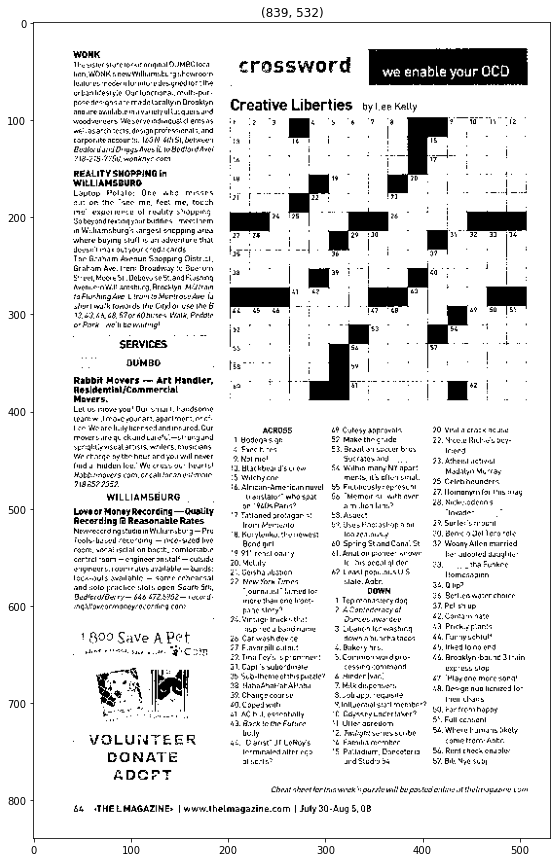

In [211]:
sudo_ret, sudo_thresh = cv2.threshold(src = img_2,thresh = 127, maxval = 255, type = cv2.THRESH_BINARY)

show_pic(sudo_thresh)

### Adaptive Threshold

https://stackoverflow.com/questions/28763419/adaptive-threshold-parameters-confusion

    @param src Source 8-bit single-channel image.
    .   @param dst Destination image of the same size and the same type as src.
    .   @param maxValue Non-zero value assigned to the pixels for which the condition is satisfied
    .   @param adaptiveMethod Adaptive thresholding algorithm to use, see #AdaptiveThresholdTypes.
    .   The #BORDER_REPLICATE | #BORDER_ISOLATED is used to process boundaries.
    .   @param thresholdType Thresholding type that must be either #THRESH_BINARY or #THRESH_BINARY_INV,
    .   see #ThresholdTypes.
    .   @param blockSize Size of a pixel neighborhood that is used to calculate a threshold value for the
    .   pixel: 3, 5, 7, and so on.
    .   @param C Constant subtracted from the mean or weighted mean (see the details below). Normally, it
    .   is positive but may be zero or negative as well.

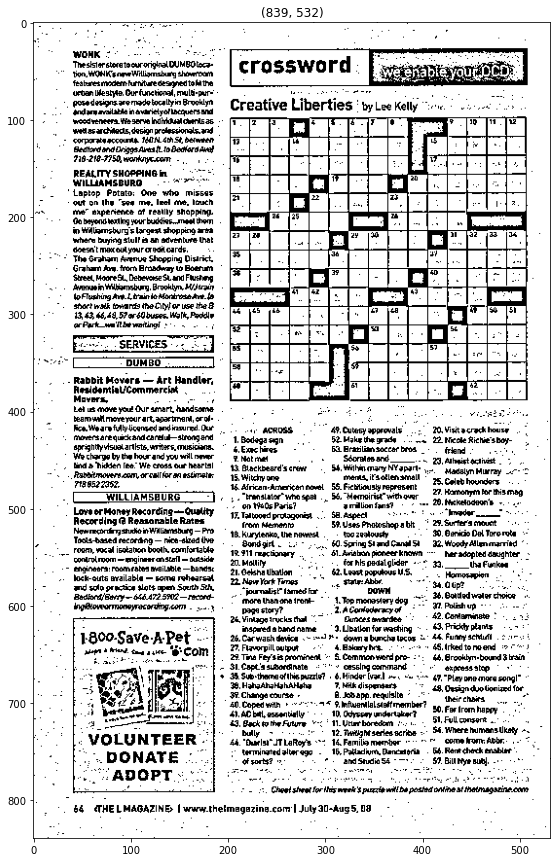

In [230]:
sudo_thresh1 = cv2.adaptiveThreshold(src = img_2,maxValue = 255, adaptiveMethod = cv2.ADAPTIVE_THRESH_MEAN_C,
                                    thresholdType = cv2.THRESH_BINARY,blockSize = 11, C = 8)

show_pic(sudo_thresh1)

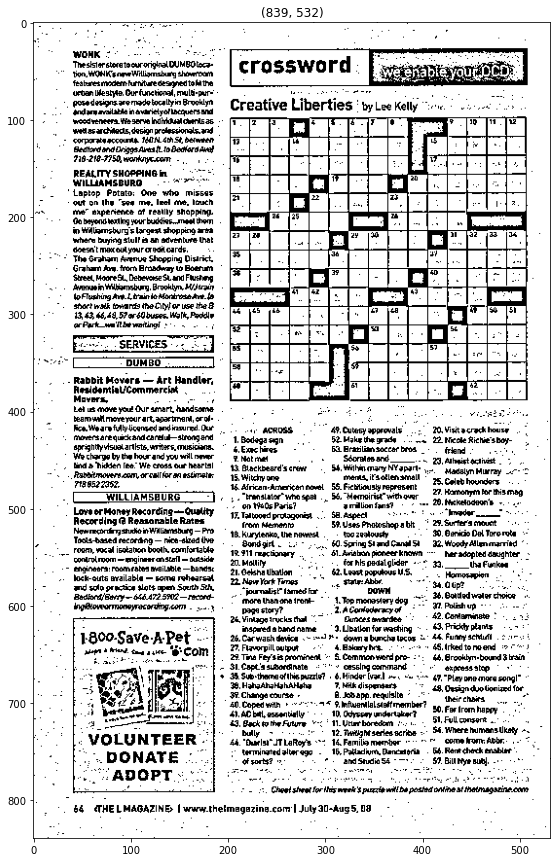

In [231]:
sudo_thresh2 = cv2.adaptiveThreshold(src = img_2,maxValue = 255, adaptiveMethod = cv2.ADAPTIVE_THRESH_MEAN_C,
                                    thresholdType = cv2.THRESH_BINARY,blockSize = 15, C = 8)

show_pic(sudo_thresh1)

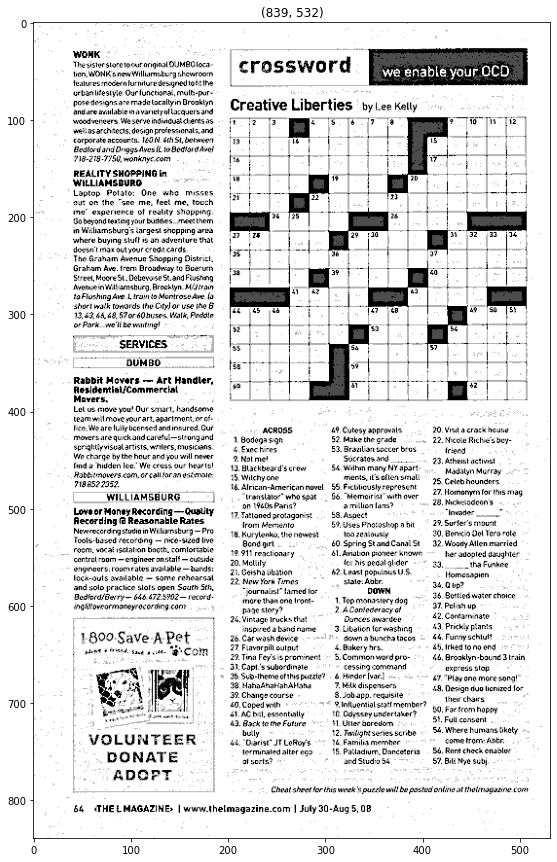

In [232]:
blended = cv2.addWeighted(src1 = sudo_thresh, alpha = 0.7 , src2 = sudo_thresh1, beta = 0.3, gamma = 0)
show_pic(blended)

---

## Blurring and Smoothing

In [233]:
# Smoothing noise'dan kurtarır ve genel detaylarına odaklanmayı sağlar !!!
# Egde Detection için birleşimde kullanılır !!!

In [234]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [237]:
def load_img():
    
    path = "DATA/bricks.jpg"
    img = cv2.imread(path).astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [246]:
def display_img(img):
    
    fig = plt.figure(figsize = (12,10))
    ax = fig.add_subplot(111)
    ax.set_title(f"Shape : {img.shape}",fontsize = 15)
    ax.imshow(img)

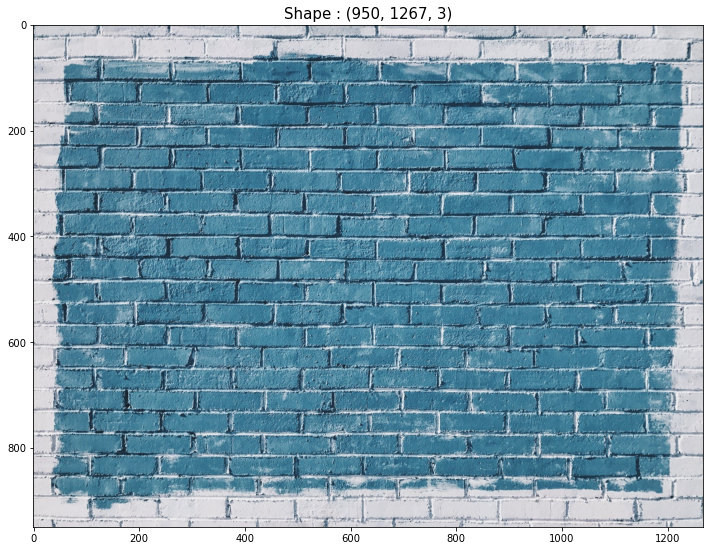

In [247]:
i = load_img()
display_img(i)

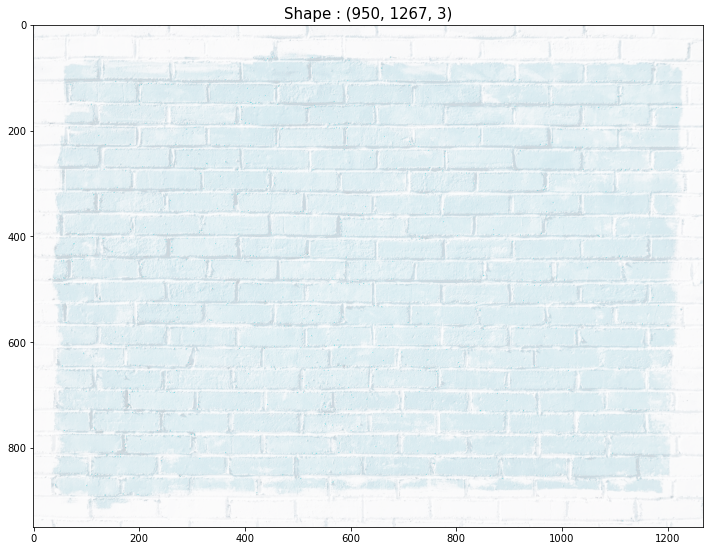

In [251]:
gamma = 1/10
result = np.power(i,gamma)
display_img(result)

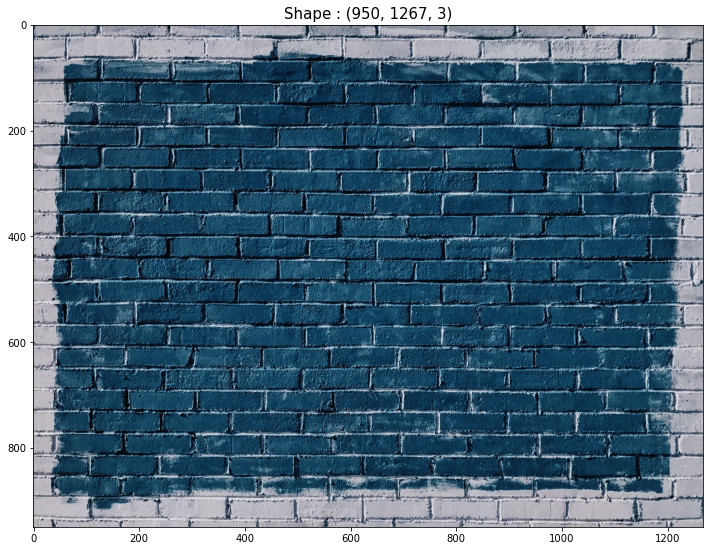

In [254]:
# Gamma Arttıkça daha koyulaşıyor .....
gamma = 2
result = np.power(i ,gamma)
display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


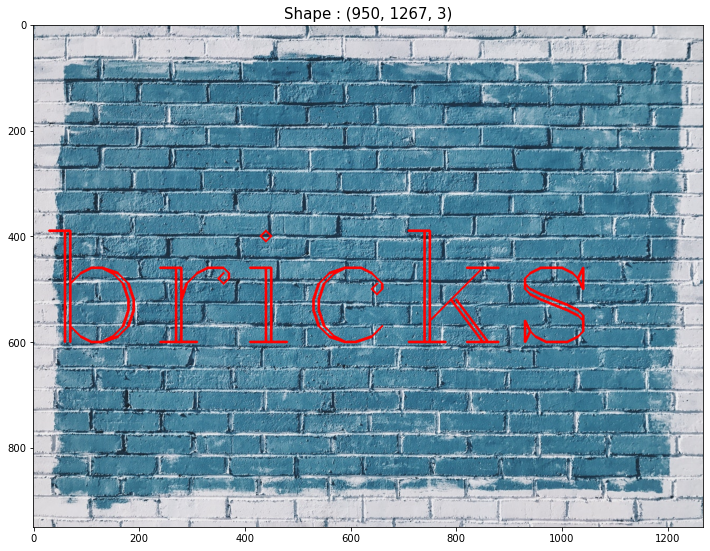

In [256]:
result_1 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX

font_img = cv2.putText(img = result_1, text = "bricks", org = (10,600), fontFace =  font, fontScale = 10, color = (255,0,0),
                       thickness = 4)

display_img(font_img)

In [259]:
kernel = np.ones(shape = (5,5), dtype = np.float32) / 25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


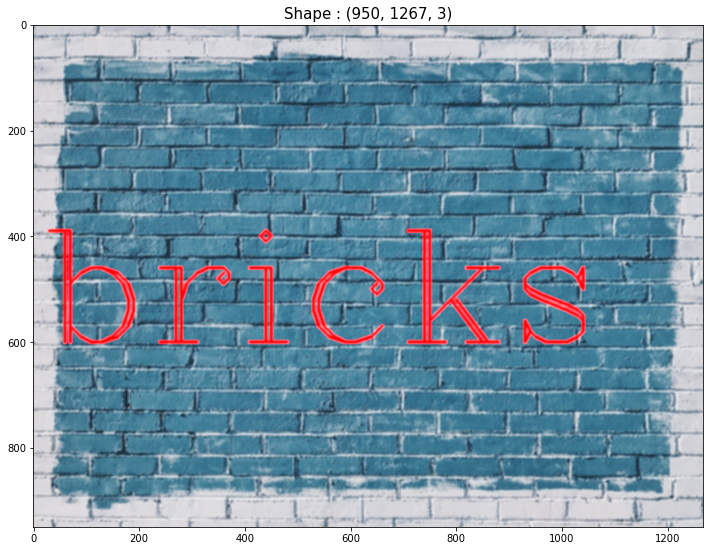

In [261]:
dst = cv2.filter2D(src = font_img, ddepth = -1,kernel = kernel)
display_img(dst)

---

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


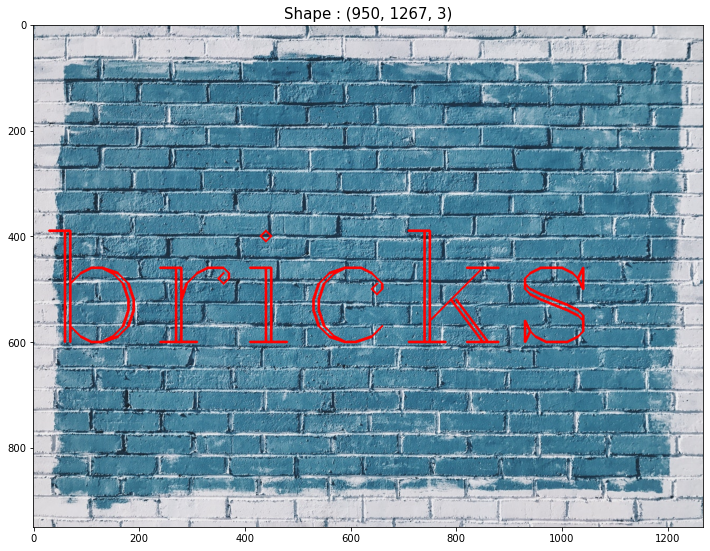

In [270]:
# Reset

result_1 = load_img()
font = cv2.FONT_HERSHEY_COMPLEX

cv2.putText(img = result_1, text = "bricks", org = (10,600), fontFace =  font, fontScale = 10, color = (255,0,0),
                       thickness = 4)

display_img(result_1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


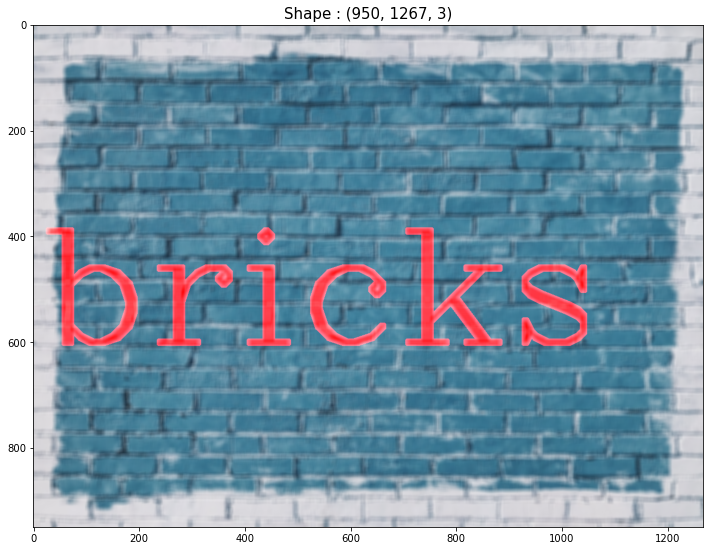

In [273]:
blurred = cv2.blur(src = result_1,ksize = (10,10))
display_img(blurred)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


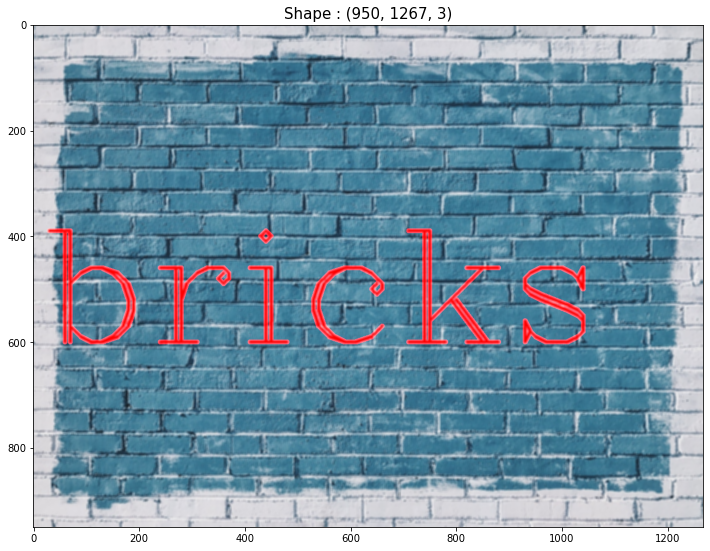

In [275]:
GaussionBlur_img = cv2.GaussianBlur(src = result_1,ksize = (5,5), sigmaX = 10)
display_img(GaussionBlur_img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


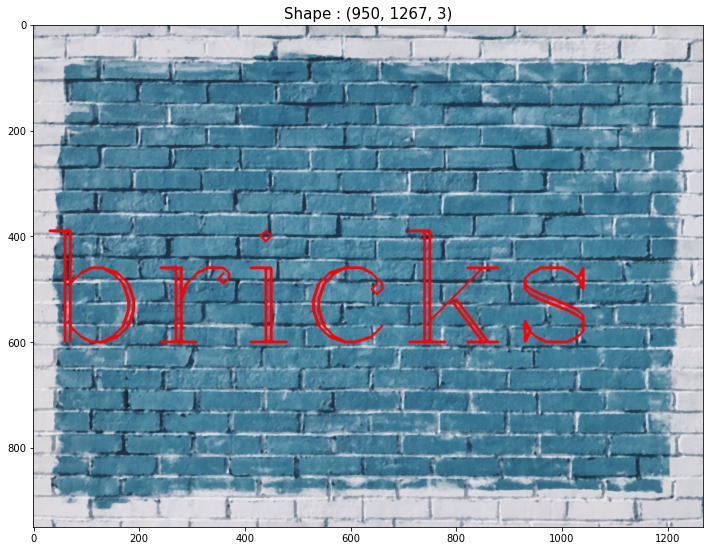

In [280]:
MedianBlur_img = cv2.medianBlur(src = result_1, ksize = 5)
display_img(MedianBlur_img)

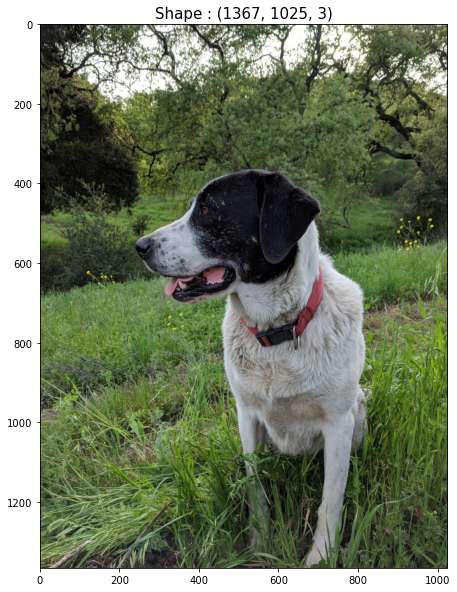

In [281]:
sammy = cv2.imread("DATA/sammy.jpg")
sammy = cv2.cvtColor(sammy, cv2.COLOR_BGR2RGB)
display_img(sammy)

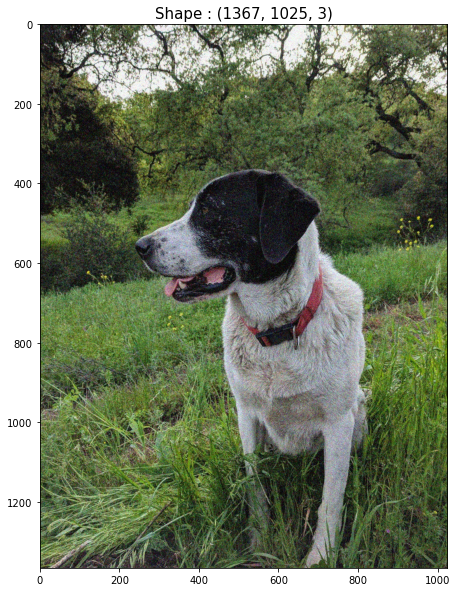

In [282]:
sammy_noise = cv2.imread("DATA/sammy_noise.jpg")
display_img(sammy_noise)

#### 

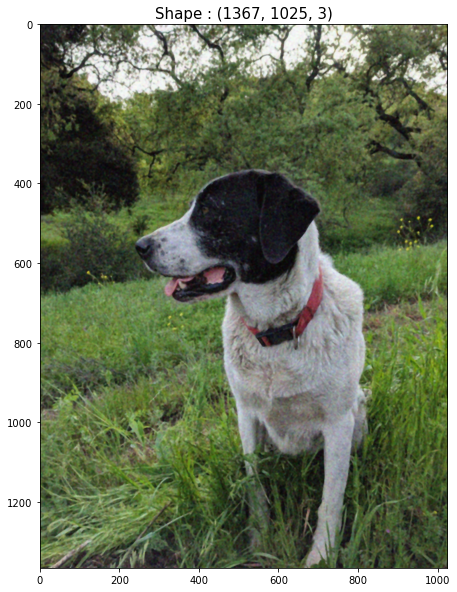

In [283]:
median_sammy = cv2.medianBlur(src = sammy_noise, ksize = 5)
display_img(median_sammy)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


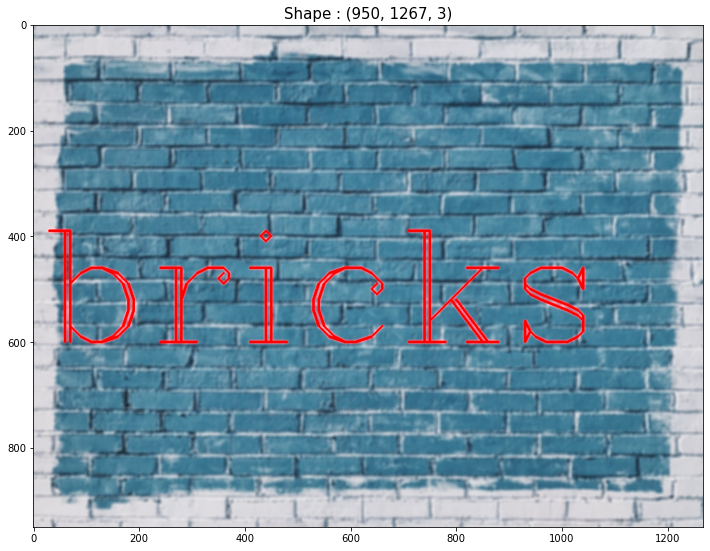

In [284]:
bilateral_img = cv2.bilateralFilter(src = result_1,d = 9, sigmaColor = 75 ,sigmaSpace = 75)
display_img(bilateral_img)

---

## Morphological Operators

- Noise azaltır.

- Beyaz arka plan üzerinde ki siyah nokları azaltır. (yada Tam tersi)

- Metinler üzerinde daha etkilidir.

In [303]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


def load_img():
    
    blank_img = np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img, text = "ABCDR", org = (50,300), fontFace = font, fontScale = 5, color = (255,255,255),
                thickness =30 )
    
    return blank_img

def display_img(img):
    
    fig = plt.figure(figsize = (12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap ="gray")

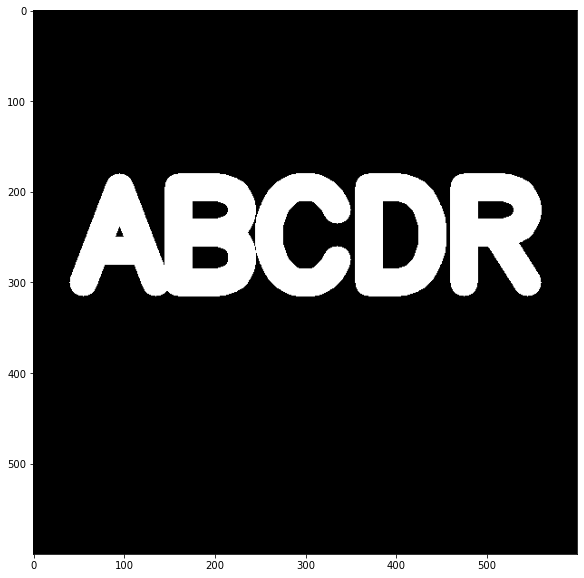

In [304]:
result = load_img()
display_img(result)

In [305]:
kernel = np.ones((5,5), dtype = np.uint8)
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

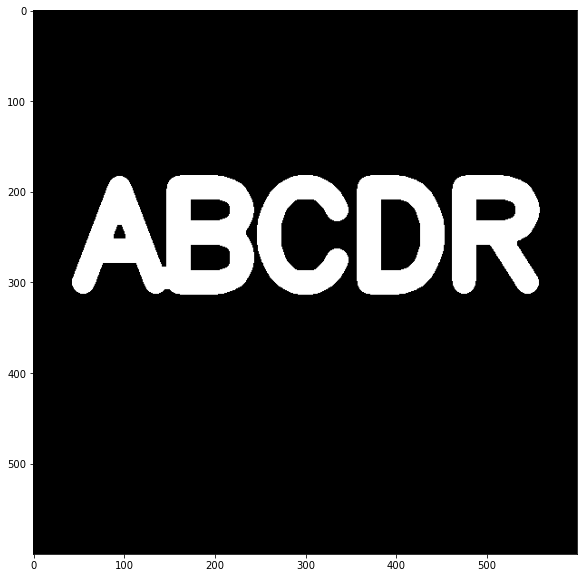

In [311]:
erode = cv2.erode(result, kernel, iterations = 1)
display_img(erode)

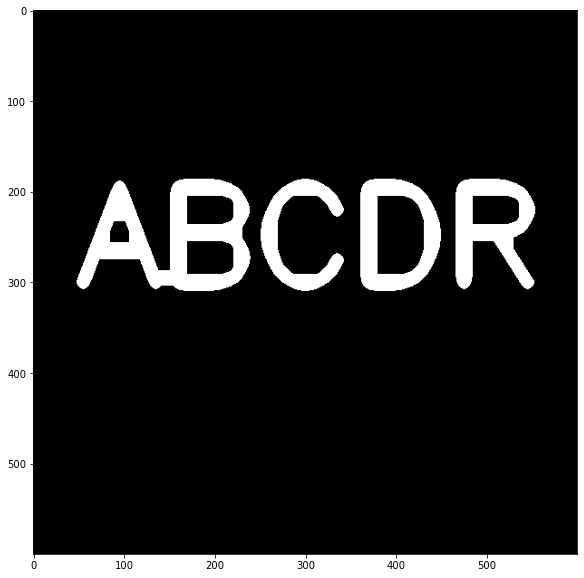

In [312]:
erode2 = cv2.erode(result, kernel, iterations = 3)
display_img(erode2)

---

In [333]:
white_noise = np.random.randint(low = 0, high = 2, size = (600,600))
white_noise

array([[1, 1, 0, ..., 0, 0, 1],
       [0, 1, 1, ..., 1, 1, 1],
       [1, 0, 1, ..., 1, 1, 1],
       ...,
       [0, 1, 0, ..., 1, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 0]])

In [334]:
white_noise.max(),white_noise.min()

(1, 0)

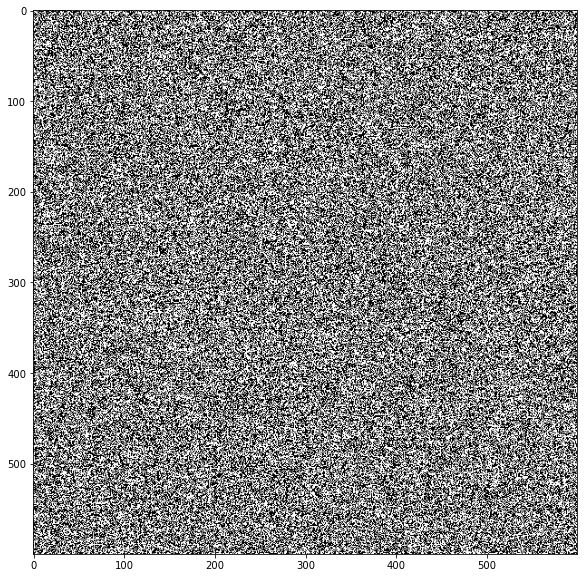

In [335]:
display_img(white_noise)

In [336]:
result.max(),result.min()

(255.0, 0.0)

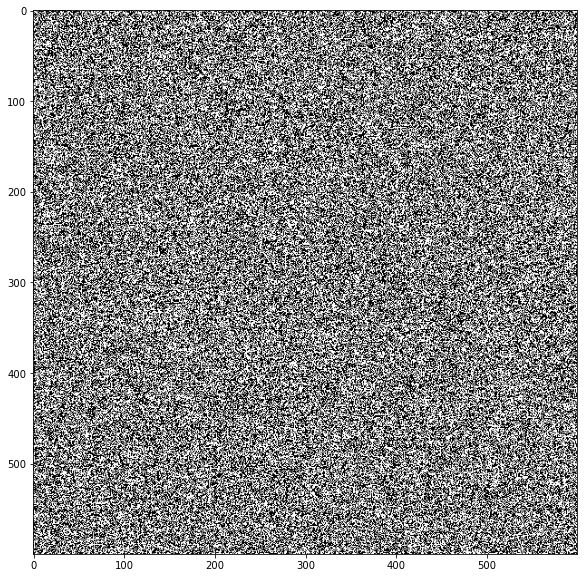

In [337]:
white_noise = white_noise * 255
display_img(white_noise)

In [338]:
noise_img = white_noise + result
noise_img.max(),noise_img.min()

(510.0, 0.0)

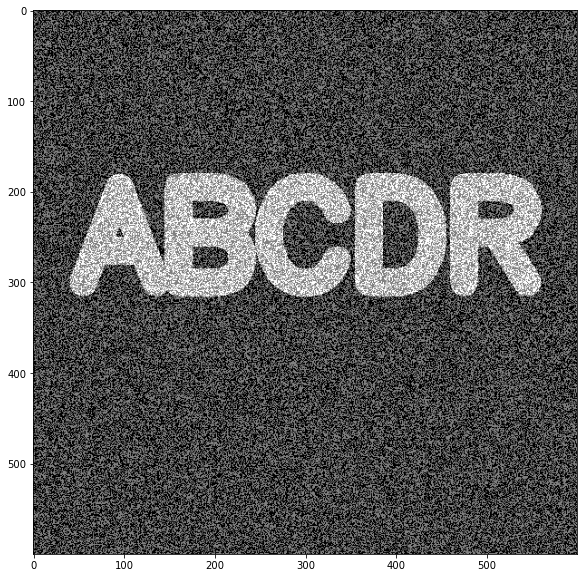

In [340]:
display_img(noise_img)

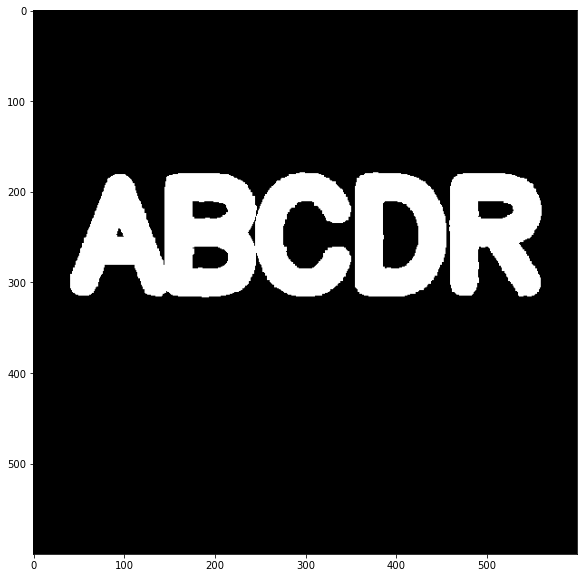

In [342]:
opening = cv2.morphologyEx(noise_img,cv2.MORPH_OPEN,kernel)
display_img(opening)

In [343]:
result = load_img()

black_noise = np.random.randint(low = 0, high = 2, size = (600,600))
black_noise = black_noise * -255
black_noise.max(),black_noise.min()


(0, -255)

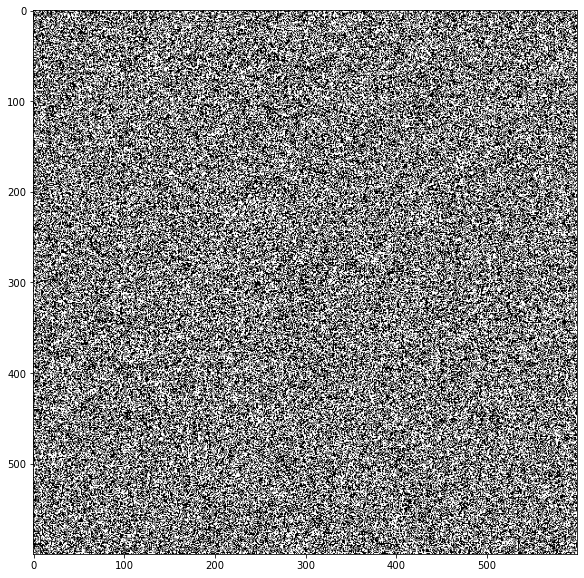

In [344]:
display_img(black_noise)

In [345]:
black_noise_img = black_noise + result
black_noise_img.max(),black_noise_img.min()

(255.0, -255.0)

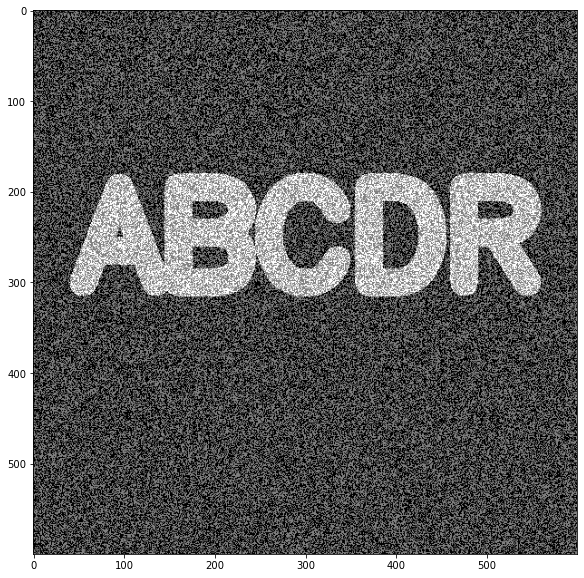

In [346]:
display_img(black_noise_img)

In [348]:
black_noise_img[black_noise_img == -255] = 0
black_noise_img.min()

0.0

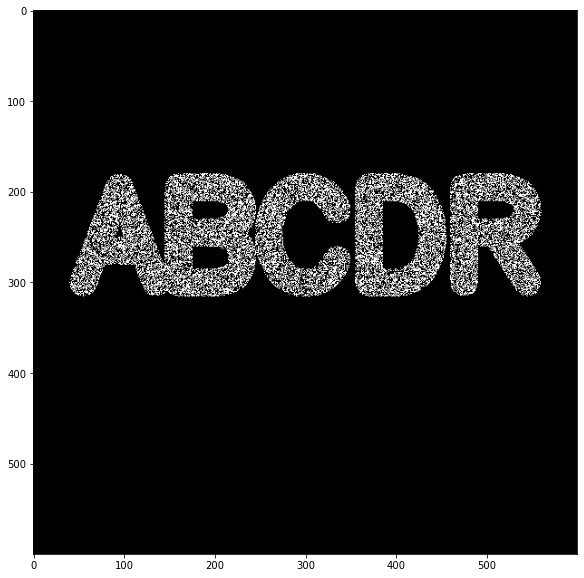

In [349]:
display_img(black_noise_img)

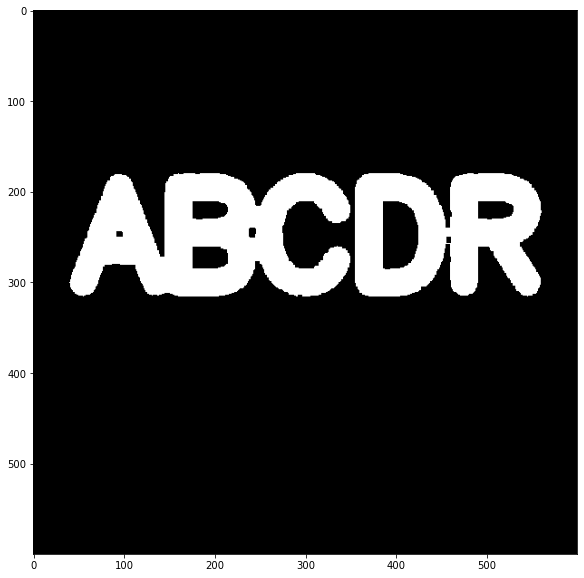

In [350]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)
display_img(closing)

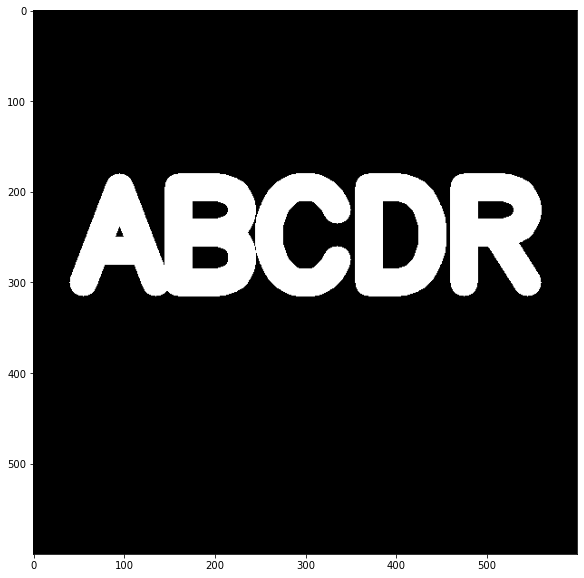

In [351]:
result = load_img()
display_img(result)

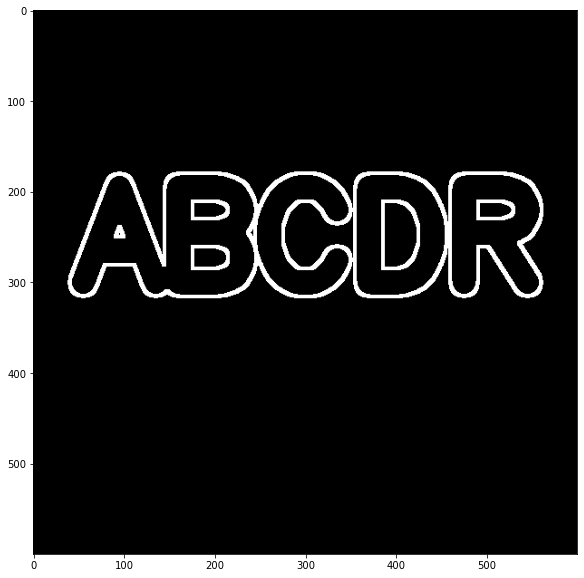

In [352]:
gradient = cv2.morphologyEx(result, cv2.MORPH_GRADIENT, kernel)
display_img(gradient)

---

## Gradients

In [353]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [358]:
def display_img(image):
    fig = plt.figure(figsize = (12,10))
    ax = fig.add_subplot(111)
    ax.imshow(image, cmap = "gray")    

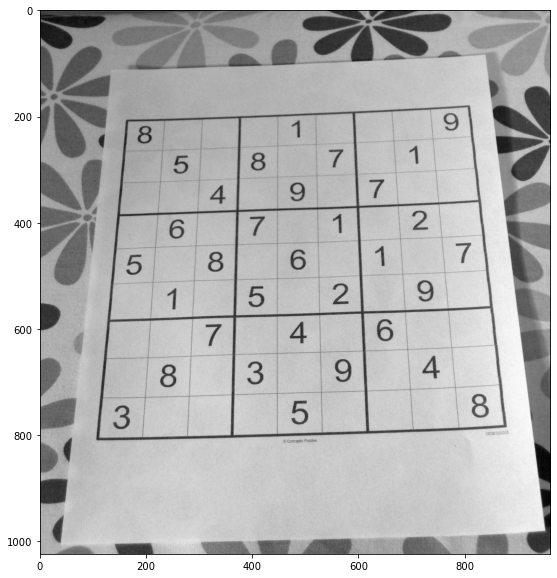

In [360]:
img = cv2.imread("DATA/sudoku.jpg",0)
display_img(img)

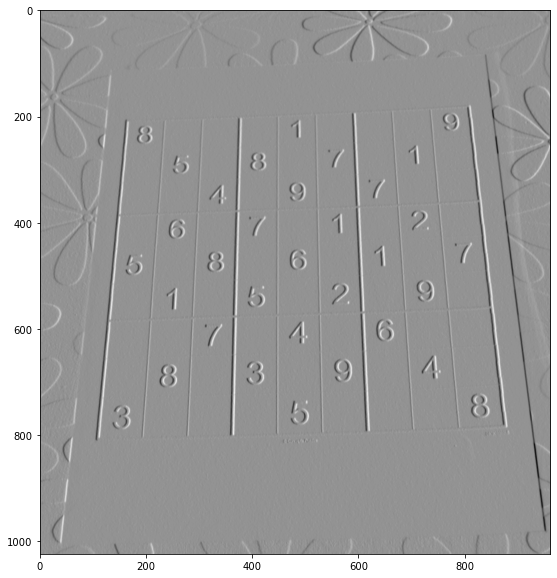

In [362]:

sobelx = cv2.Sobel(src = img , ddepth = cv2.CV_64F, dx = 1, dy = 0, ksize = 5)
display_img(sobelx)

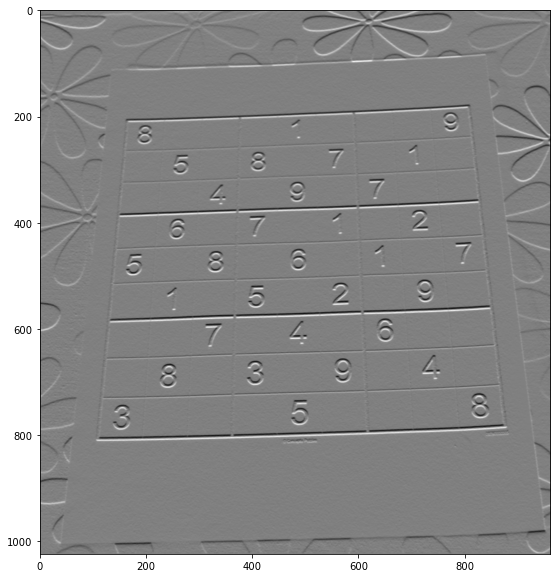

In [363]:
sobely = cv2.Sobel(src = img , ddepth = cv2.CV_64F, dx = 0, dy = 1, ksize = 5)
display_img(sobely)

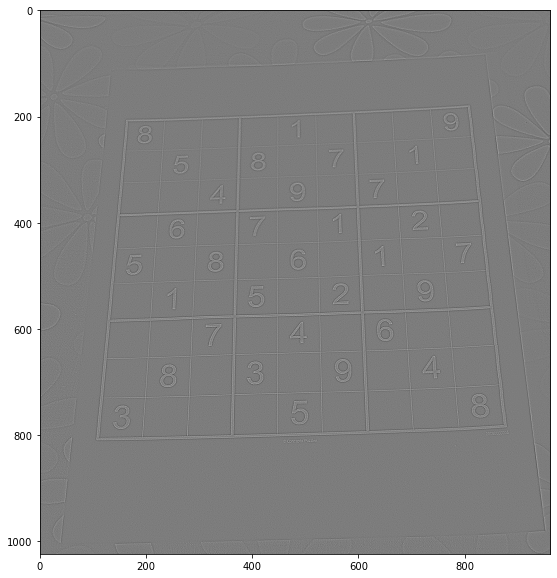

In [364]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)
display_img(laplacian)

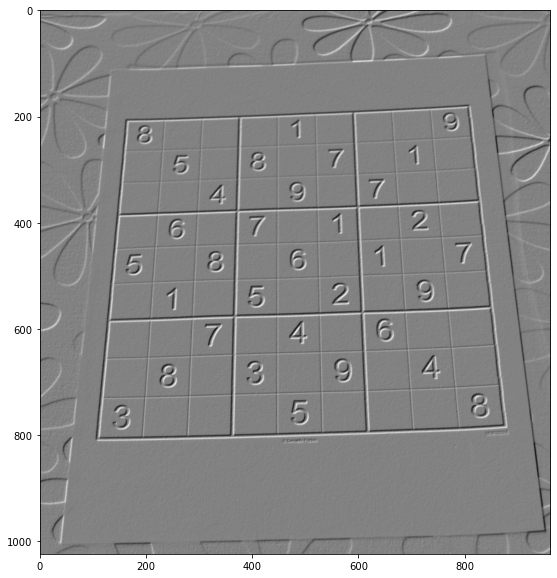

In [365]:
blended = cv2.addWeighted(src1 = sobelx, alpha = 0.5, src2 = sobely, beta = 0.5, gamma = 0)
display_img(blended)

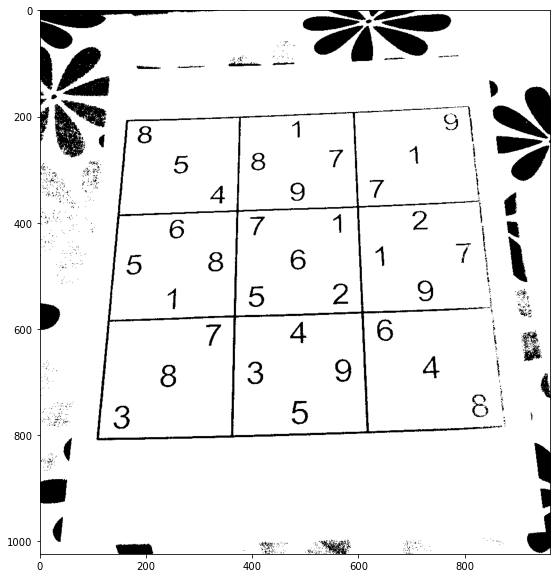

In [367]:
ret,th1 = cv2.threshold(src = img,thresh = 100,maxval = 255,type = cv2.THRESH_BINARY)
display_img(th1)

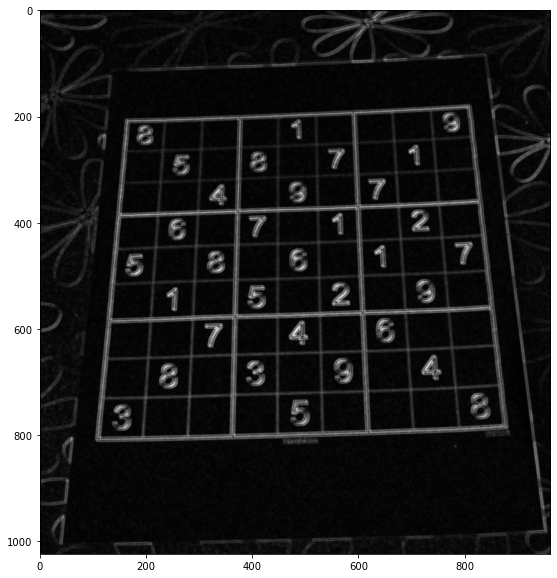

In [368]:
kernel = np.ones((4,4), np.uint8)
gradient = cv2.morphologyEx(blended, cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

---

In [411]:
dark_horse = cv2.imread("DATA/horse.jpg")
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread("DATA/rainbow.jpg")
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread("DATA/bricks.jpg")
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

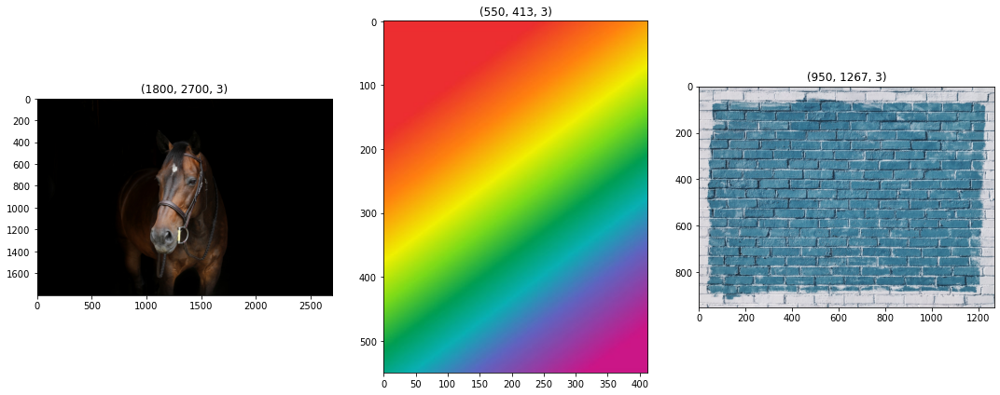

In [412]:
plt.figure(figsize = (15,6))

plt.subplot(1,3,1)
plt.imshow(show_horse)
plt.title(show_horse.shape)

plt.subplot(1,3,2)
plt.imshow(show_rainbow)
plt.title(show_rainbow.shape)

plt.subplot(1,3,3)
plt.imshow(show_bricks)
plt.title(show_bricks.shape)

plt.tight_layout()
plt.show()

In [413]:
# OpenCV BGR
# RGB dönüşülmedi Bak Dikkat !!!

bricks_hist= cv2.calcHist([blue_bricks],channels = [0], mask =None, histSize = [256], ranges = [0,256])
horse_hist = cv2.calcHist([dark_horse], channels = [0], mask = None, histSize = [256], ranges = [0,256])
bricks_hist.shape,horse_hist.shape

((256, 1), (256, 1))

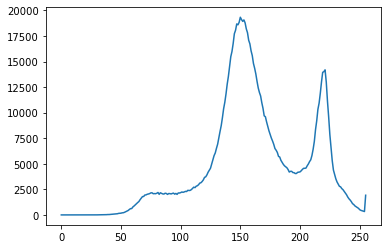

In [414]:
plt.plot(bricks_hist)

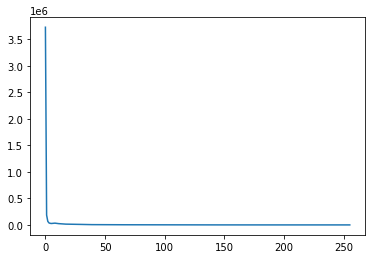

In [415]:
plt.plot(horse_hist)

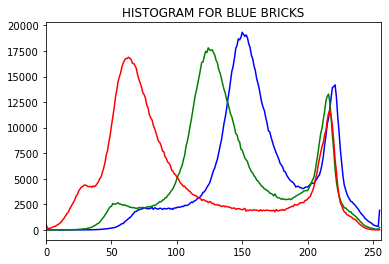

In [416]:
color = ("b","g","r")

for i,col in enumerate(color):
    
    histr = cv2.calcHist([blue_bricks],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    
plt.title("HISTOGRAM FOR BLUE BRICKS")
plt.show()

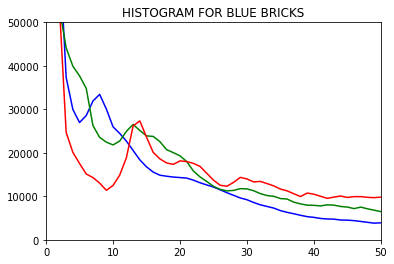

In [417]:
color = ("b","g","r")

for i,col in enumerate(color):
    
    histr = cv2.calcHist([dark_horse],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,50])
    plt.ylim([0,50000])
    
plt.title("HISTOGRAM FOR BLUE BRICKS")
plt.show()

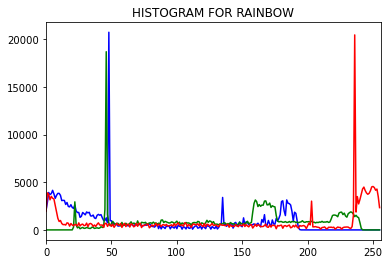

In [418]:
color = ("b","g","r")

for i,col in enumerate(color):
    
    histr = cv2.calcHist([rainbow],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    
plt.title("HISTOGRAM FOR RAINBOW")
plt.show()

In [419]:
rainbow.shape

(550, 413, 3)

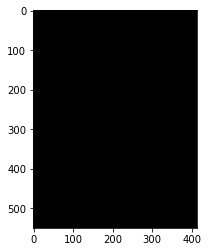

In [420]:
mask = np.zeros(rainbow.shape[:2],np.uint8)
plt.imshow(mask,cmap = "gray")
plt.show()

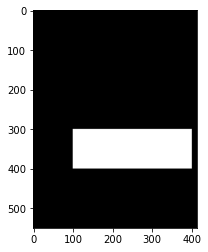

In [421]:
mask[300:400,100:400] = 255
plt.imshow(mask,cmap = "gray")
plt.show()

In [424]:
masked_img = cv2.bitwise_and(rainbow,rainbow,mask = mask)

show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow, mask = mask)

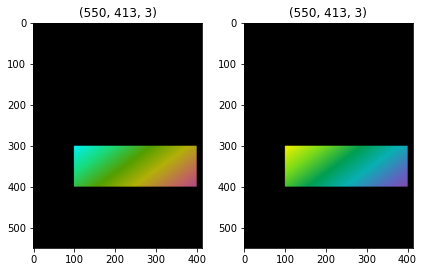

In [426]:
plt.subplot(1,2,1)
plt.imshow(masked_img)
plt.title(masked_img.shape)

plt.subplot(1,2,2)
plt.imshow(show_masked_img)
plt.title(show_masked_img.shape)

plt.tight_layout()
plt.show()

In [428]:
hist_mask_values_red = cv2.calcHist([rainbow],channels = [2], mask = mask, histSize = [256], ranges = [0,256])
hist_values_red = cv2.calcHist([rainbow],channels = [2], mask = None, histSize = [256], ranges = [0,256])

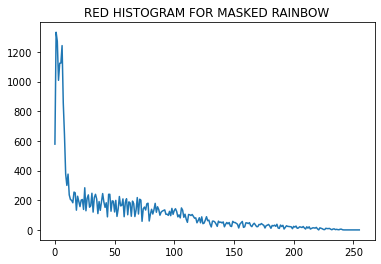

In [432]:
plt.plot(hist_mask_values_red)
plt.title("RED HISTOGRAM FOR MASKED RAINBOW")
plt.show()

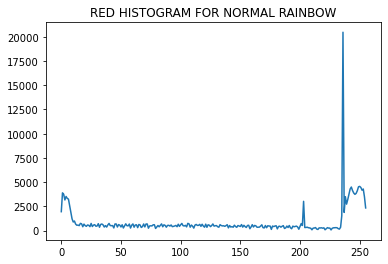

In [435]:
plt.plot(hist_values_red)
plt.title("RED HISTOGRAM FOR NORMAL RAINBOW")
plt.show()